# Efficient Harbor Craft Monitoring System: Time-Series Data Analytics and Machine Learning Tools to Achieve Fuel Efficiency by Operational Scoring System

### Code for Paper Demonstration

In [2]:
# Do this only once to install necessary libraries/packages
# Requires python version 3.8.10

!pip install -r requirements.txt --user

In [64]:
# Import necessary libraries

import os
import util
import pickle
import numpy as np
import pandas as pd
import matplotlib.cm as cm
import matplotlib.pyplot as plt
from concurrent.futures import ThreadPoolExecutor, as_completed
from sklearn.metrics import auc, mean_squared_error
from sklearn.preprocessing import normalize
from scipy.ndimage import gaussian_filter
# from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import KMeans
from operator import itemgetter
from datetime import datetime
from celluloid import Camera
from tqdm import tqdm

import matplotlib
matplotlib.rc('font', size=8)

In [65]:
# Load the cleaned and resampled dataset
# This is raw dataset prepared for demonstration only

with open(os.path.join('pkl', 'dataset_5s.pkl'), 'rb') as f:
    ds = pickle.load(f)
indices, segments, segments_wind, segments_location = ds['index'], ds['bunker'], ds['wind'], ds['location']

# The number of segments indicate the jobs the boat has performed
# Segment length (time) is irregular

print('Number of data segments', len(indices))

Number of data segments 100


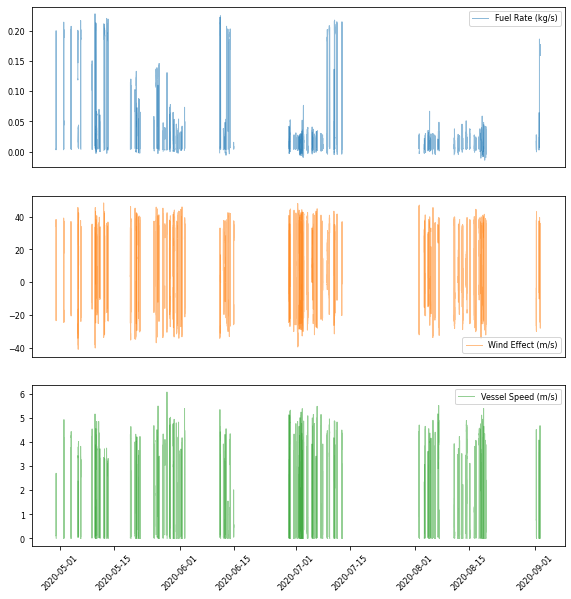

In [66]:
# All raw dataset

raw = []
fig, axs = plt.subplots(3, 1, figsize=(8, 8), num='Raw Dataset')
fig.tight_layout()
axs[0].set_xticks([]); axs[1].set_xticks([])
[tick.set_rotation(45) for tick in axs[2].get_xticklabels()]
for i, (fr, we, vs) in enumerate(zip(segments, segments_wind, segments_location)):
    r = pd.concat([fr.sum(axis=1), we['effect'], vs['distance']], axis=1)
    r.columns = ['Fuel Rate (kg/s)', 'Wind Effect (m/s)', 'Vessel Speed (m/s)']
    for j, clr in enumerate(['tab:blue', 'tab:orange', 'tab:green']):
        if i == 0:
            axs[j].plot(r.index, r.iloc[:,j], linewidth=1, c=clr, alpha=0.5, label=list(r.columns)[j])
        else:
            axs[j].plot(r.index, r.iloc[:,j], linewidth=1, c=clr, alpha=0.5)
    raw.append(r)
raw = pd.concat(raw)
[axs[i].legend(loc='best') for i in range(3)]
plt.show();

In [67]:
# Assign one segment as a test segment
# The test segment is excluded in knowledge base (KB) dataset (for training)
# If total data segments is 100, only 99 is used to generate KB
# It is for testing the accuracy of KB later

test_segment = 2
# test_segment = 83

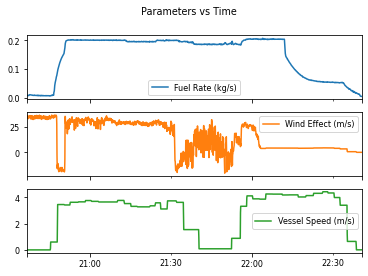

In [68]:
# View test_segment data
# Other segments have same structure

view = pd.concat([segments[test_segment].sum(axis=1), 
                  segments_wind[test_segment]['effect'], 
                  segments_location[test_segment]['distance']], 
                 axis=1)
view.columns = ['Fuel Rate (kg/s)', 'Wind Effect (m/s)', 'Vessel Speed (m/s)']
view.plot(subplots=True, title='Parameters vs Time');

In [69]:
# Test segment metadata

t_delta = (view.index[-1]-view.index[0]).seconds
print(f"Test segment number: {test_segment}")
print(f"The data period: {view.index[0].strftime('%d-%b-%y %H:%M:%S %p')} to {view.index[-1].strftime('%d-%b-%y %H:%M:%S %p')}")
print(f"The duration: {t_delta//3600} hrs, {t_delta%60} mins, {t_delta//3600%60} secs")
print(f"Interval: {np.unique(np.diff(view.index))[0].seconds} secs")
print(f"Number of data points: {view.shape[0]}")

Test segment number: 2
The data period: 03-May-20 20:36:35 PM to 03-May-20 22:40:30 PM
The duration: 2 hrs, 55 mins, 2 secs
Interval: 5 secs
Number of data points: 1488


## 1. Score Space

As the raw dataset is time-series in nature, it is necessary to convert it to points (the purpose of points is explained later).  
The dimension needs to be reduced from 1 (line/curve) to 0 (point).  

The raw data is cut into uniform subsets.  
The subsets are arranged in parallel, then clustered using time-series clustering.  
The number of clusters is determined by **n_class**.  
Each cluster has 1-dimension cluster center.  
Applying simple average generates a point to represent all subsets associated to a particular cluster center.  

Completing this step enables all parameters to be in the same domain (score). 

In [70]:
%%time

# Convert raw dataset to score dataset
# `n_class` determines the score range
# `stride` is the number of points to skip to the beginning of next subset from current (subset explained later)
# `time_constant` is number of points in one subset

n_class = 100       # if 100, score range is 0 to 99
stride = 3          # 5s x 3    = 15 secs
time_constant = 12  # 5x x 12   = 60 secs

# Change to `True` to process locally or to `False` to load from file
if False:
    # Running this line takes some time
    signals, scores, estimators = util.get_scores(segments, segments_wind, segments_location, 
                                                stride=stride,
                                                time_constant=time_constant,
                                                n_cluster=n_class)
else:
    with open(os.path.join('pkl', 'sse.pkl'), 'rb') as f:
        signals, scores, estimators = pickle.load(f)

# signals: joined raw segments (as array), scores: output in score form (as array), estimators: TimeSeriesKMeans estimator and hash
# Each has three elements (fuel, wind, speed)

Wall time: 46.8 ms


In [71]:
%matplotlib ipympl

fig, axs = plt.subplots(1, 3, figsize=(12, 4), num='Signal Subset Creation for Time Series Clustering')
# plt.xlim((0, score[0].shape[0]))
# plt.ylim((0, 100))

camera = Camera(fig)
bgn = 0
subsets = []
for i in np.linspace(0, signals[0][test_segment].shape[0], 125)[1:]:
    end = int(i)
    subset = signals[0][test_segment][bgn:end]
    subsets.append(subset)
    axs[0].plot(np.arange(bgn, end), subset, c='r', linewidth=3)
    for s in subsets:
        axs[1].plot(s, c='k', alpha=0.25, linewidth=1)
    camera.snap()
    bgn = end
axs[0].plot(signals[0][test_segment], c='k', alpha=0.25, linewidth=1)
axs[0].set_title('Fuel Rate (FR) vs Time')
axs[0].set_xlabel('Time (s)')
axs[0].set_ylabel('FR (kg/s)')
axs[1].axis('off')
axs[1].axis('off')
axs[1].set_title('FR vs Time Delta | Cumulative')

animation = camera.animate()

for s in subsets:
    axs[2].plot(s, c='k', alpha=0.25, linewidth=1)
axs[2].set_title('FR vs Time Delta | Final')
axs[2].set_xlabel('Time Delta (s)')
plt.show();

# This block uses `test_segment` to illustrate how the subsets are generated
# One subset generates one score point

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [72]:
# Run this to stop animation

animation.event_source.stop()

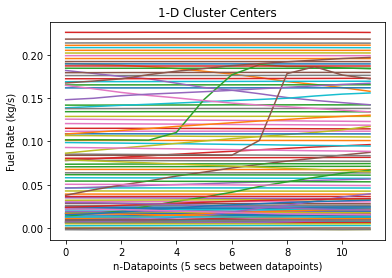

In [73]:
%matplotlib inline

# This block shows the cluster centers of the fuel rate

# estimators[0][X] 0:FR 1:WE 2:VS
centers = np.squeeze(estimators[0][0].cluster_centers_).T

plt.title('1-D Cluster Centers')
plt.plot(centers)
plt.ylabel('Fuel Rate (kg/s)')
plt.xlabel('n-Datapoints (5 secs between datapoints)')
plt.show()

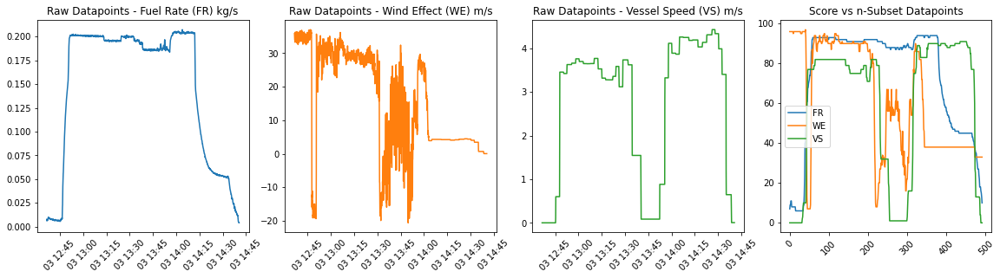

In [74]:
%matplotlib inline

fig, axs = plt.subplots(1, 4, figsize=(16,4))
fig.tight_layout()

axs[0].set_title('Raw Datapoints - Fuel Rate (FR) kg/s')
axs[0].plot(view['Fuel Rate (kg/s)'], c='tab:blue')
[tick.set_rotation(45) for tick in axs[0].get_xticklabels()]
axs[1].set_title('Raw Datapoints - Wind Effect (WE) m/s')
axs[1].plot(view['Wind Effect (m/s)'], c='tab:orange')
[tick.set_rotation(45) for tick in axs[1].get_xticklabels()]
axs[2].set_title('Raw Datapoints - Vessel Speed (VS) m/s')
axs[2].plot(view['Vessel Speed (m/s)'], c='tab:green')
[tick.set_rotation(45) for tick in axs[2].get_xticklabels()]

axs[3].set_title('Score vs n-Subset Datapoints')
axs[3].plot(scores[0][test_segment], label='FR')
axs[3].plot(scores[1][test_segment], label='WE')
axs[3].plot(scores[2][test_segment], label='VS')
[tick.set_rotation(45) for tick in axs[3].get_xticklabels()]
axs[3].legend(loc='best')

plt.show();

# The first three graphs are the raw datapoints, plotted in their own domain (unit dimension)
# Compare with the last graph (right) which allows all parameters to be plotted in the same domain

In [75]:
%matplotlib ipympl

score = np.array([scores[i][test_segment] for i in range(3)])

fig, axs = plt.subplots(1, 4, figsize=(20,5), num='Sequence in Score Space')
# fig.tight_layout()

axs[0].set_title('Fuel Rate (FR) vs n-Sample')
axs[0].set_ylabel('Score')
axs[0].set_ylim((0, n_class))
axs[1].set_title('Wind Effect (WE) vs n-Sample')
axs[1].set_xlabel('n-Sample')
axs[1].set_ylim((0, n_class))
axs[2].set_title('Vessel Speed (VS) vs n-Sample')
axs[2].set_ylim((0, n_class))
plt.xlim((0, score[0].shape[0]))

ax = fig.add_subplot(1, 4, 4, projection='3d')
ax.set_xlim3d([0, n_class])
ax.set_xlabel('FR')
ax.set_ylim3d([0, n_class])
ax.set_ylabel('WE')
ax.set_zlim3d([0, n_class])
ax.set_zlabel('VS')
ax.set_title('3D Correlation')
ax.view_init(30, 120)

camera = Camera(fig)
for i in np.linspace(0, score[0].shape[0], 100):
    i = int(i)
    axs[0].plot(score[0,:i], c='tab:blue')
    axs[1].plot(score[1,:i], c='tab:orange')
    axs[2].plot(score[2,:i], c='tab:green')
    ax.plot(score[0,:i], score[1,:i], score[2,:i], c='k', alpha=0.5, linewidth=1)
    ax.scatter(score[0,:i], score[1,:i], score[2,:i], c='k', s=25, alpha=0.25, edgecolor='white')
    camera.snap()
axs[3].axis('off')

animation = camera.animate()

# Score domain also preserves sequence (time-series) information

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [76]:
animation.event_source.stop()

## 2. Point Clustering

Sequence information is not used in point clustering.  
Clustering uses K-Means to unsupervisedly create n number of clusters (cluster size).  
The clusters are acceepted once cluster quality value reaches certain value (e.g. ~1).  
If desired cluster quality has not been achieved, repeat or increase cluster size or both.  
After clustering is done, the sequence information is returned back.  

In [77]:
%%time

# Remove `test_segment` from datapoints
# Bias is for stretching/squeezing a particular axial space to purposefully make points closer or away
# Lower is closer
biases = [1, 1, 1]

# create datapoints, and apply bias
b = np.concatenate([score for enum, score in enumerate(scores[0]) if enum != test_segment]) * biases[0]
w = np.concatenate([score for enum, score in enumerate(scores[1]) if enum != test_segment]) * biases[1]
d = np.concatenate([score for enum, score in enumerate(scores[2]) if enum != test_segment]) * biases[2]
datapoints = np.vstack([b, w, d]).T

Wall time: 998 µs


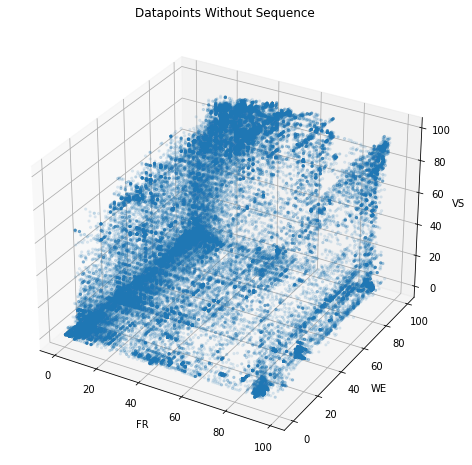

In [78]:
%matplotlib inline

fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
ax.scatter(datapoints[:, 0], datapoints[:, 1], datapoints[:, 2], 
           alpha=0.1, marker='.')
ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
ax.set_title(f"Datapoints Without Sequence")
plt.show();

# All data (except `test_segment`) 3D scatter plot prior to clustering

In [79]:
n_cluster = 300
infinite_breaker = 500
cluster_quality_thresh = 1
centers = None

In [80]:
# Load pre-determined cluster centers
# Change to `False` to randomly seed the new clusters
if True:
    with open(os.path.join('pkl', 'centers_300.pkl'), 'rb') as f:
        centers = pickle.load(f)
    n_cluster = centers.shape[0]
    centers.shape

In [81]:
%%time

# K-Means clustering

n_cluster_ = n_cluster
cluster_centers = []
while True:
    if n_cluster_ > infinite_breaker:
        print('Optimum not found')
        break
    # create clusters, without noise points
    if centers is not None:
        est = KMeans(n_clusters=n_cluster_, init=centers)
    else:
        est = KMeans(n_clusters=n_cluster_)
    est.fit(datapoints)

    # inverse mean square error
    cluster_quality = [np.linalg.norm(datapoints[est.labels_==i] - est.cluster_centers_[i], axis=1) for i in range(n_cluster_)]
    cluster_quality = n_class / np.array([np.mean(cq**2) for cq in cluster_quality])
    # cluster labels accepted
    accepted = cluster_quality >= cluster_quality_thresh
    print(f"n_cluster: {n_cluster_}, minimum cluster quality: {np.min(cluster_quality)}")
    # accept or exit
    if not np.all(accepted) and centers is None:
        # n_cluster_ += 5
        pass
    else:
        break

print('\nnumber of clusters:', est.cluster_centers_.shape[0], '\n')
n_cluster = est.cluster_centers_.shape[0]

C:\Users\tzy\.conda\envs\demo\lib\site-packages\sklearn\cluster\_kmeans.py:984: RuntimeWarning: Explicit initial center position passed: performing only one init in KMeans instead of n_init=10.
  self._check_params(X)
n_cluster: 300, minimum cluster quality: 0.9116773054134042

number of clusters: 300 

Wall time: 4.05 s


Number of member of five smallest clusters: 29 41 42 44 48 

Largest cluster  : #167, 1865 members
Smallest cluster : #283, 29 members


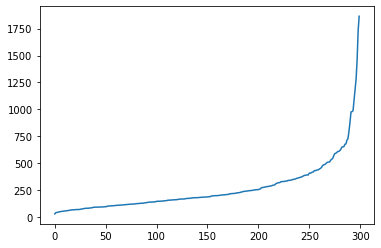

In [82]:
%matplotlib inline

sorted_members = np.array(sorted([est.labels_[est.labels_==i].shape[0] for i in range(np.unique(est.labels_).shape[0])]))
print('Number of member of five smallest clusters:', *sorted_members[:5], '\n')
unq, cts = np.unique(est.labels_, return_counts=True)
print('Largest cluster  :', f"#{np.where(cts==sorted_members[-1])[0][0]}, {sorted_members[-1]} members")
print('Smallest cluster :', f"#{np.where(cts==sorted_members[0])[0][0]}, {sorted_members[0]} members")
plt.plot(sorted_members)
plt.show()

# Number of members from each cluster, sorted from low to high
# To check if smallest cluster is not too small (e.g. 1 member)

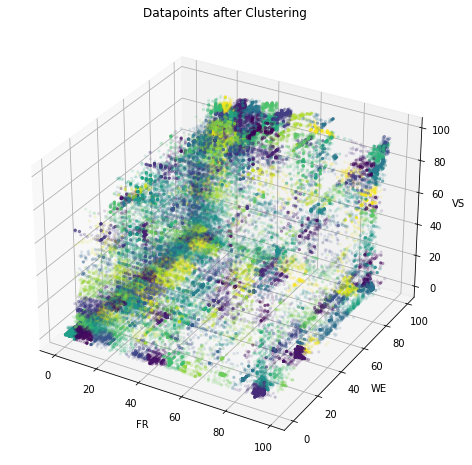

In [83]:
%matplotlib inline

datapoint_labels = est.labels_

fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
ax.scatter(datapoints[:, 0], datapoints[:, 1], datapoints[:, 2], 
           c=datapoint_labels.astype(float), alpha=0.1, marker='.')
ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
ax.set_title(f"Datapoints after Clustering")
plt.show();

# Points associated to their clusters/colors (colors may be reused)

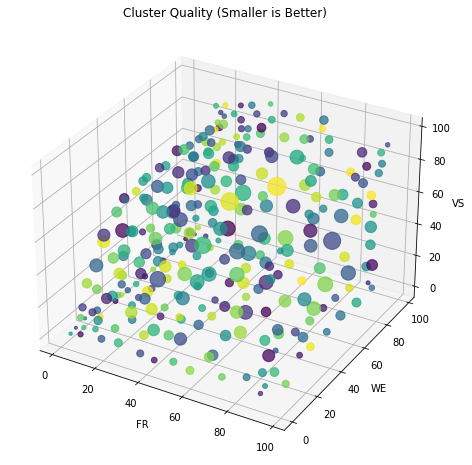

In [84]:
# Inverse mean square error
cluster_quality = [np.linalg.norm(datapoints[datapoint_labels==i] - est.cluster_centers_[i], axis=1) for i in range(n_cluster)]
cluster_quality = n_class / np.array([np.mean(cq**2) for cq in cluster_quality])

fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
ax.scatter(est.cluster_centers_[:, 0], est.cluster_centers_[:, 1], est.cluster_centers_[:, 2], 
           c=np.unique(datapoint_labels).astype(float), alpha=0.75, marker='o', 
           s=n_cluster/cluster_quality)
ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
ax.set_title(f"Cluster Quality (Smaller is Better)")
plt.show();

# Sparsely populated cluster represented as larger bubbles
# Compact clusters are smaller bubbles

In [85]:
print('Lowest quality  :', cluster_quality.min())
print('Median quality  :', np.median(cluster_quality))
print('Highest quality :', cluster_quality.max())

# Higher values indicate more compact clusters

Lowest quality  : 0.9116773054134042
Median quality  : 3.921054853559735
Highest quality : 48.6348143966447


In [86]:
ts_score = np.array([scores[i][test_segment] for i in range(3)])
X_test = np.array([scores[0][test_segment], scores[1][test_segment], scores[2][test_segment]]).T
pred = est.predict(X_test)
reassign = dict(zip(set(pred), range(len(set(pred)))))

trace = pd.DataFrame(np.vstack([pred, *ts_score]).T, columns=['CN', 'FR', 'WE', 'VS']).T
trace

# Table showing the sequence of `test_segment` passing through different clusters (CN)

,0,1,2,3,4,5,6,7,8,9,...,482,483,484,485,486,487,488,489,490,491
CN,45,36,36,36,36,36,36,36,36,36,...,287,287,287,287,161,161,161,161,161,161
FR,7,9,9,11,11,8,8,8,8,8,...,27,24,22,18,18,18,16,15,13,10
WE,96,96,96,96,96,96,96,96,96,95,...,33,33,33,33,33,33,33,33,33,33
VS,0,0,0,0,0,0,0,0,0,0,...,13,13,13,12,4,4,0,0,0,0


In [87]:
# Prepare for training by putting back sequence information

dataset = util.create_dataset(n_cluster, scores, test_segment, est)

In [88]:
%matplotlib ipympl


fig, axs = plt.subplots(1, 5, figsize=(17,5), gridspec_kw={'width_ratios': [5, 1, 5, 1, 5]}, num='A Sequence Passing Through Different Clusters')
axs[0].axis('off'); axs[1].axis('off'); axs[2].axis('off'); axs[3].axis('off'); axs[4].axis('off')
fig.tight_layout()

ax0 = fig.add_subplot(1, 5, 1, projection='3d')
ax0.set_xlim3d([0, n_class])
ax0.set_xlabel('FR')
ax0.set_ylim3d([0, n_class])
ax0.set_ylabel('WE')
ax0.set_zlim3d([0, n_class])
ax0.set_zlabel('VS')
ax0.set_title('')
ax0.view_init(30, 120)

ax1 = fig.add_subplot(1, 5, 3, projection='3d')
ax1.set_xlim3d([0, n_class])
ax1.set_xlabel('FR')
ax1.set_ylim3d([0, n_class])
ax1.set_ylabel('WE')
ax1.set_zlim3d([0, n_class])
ax1.set_zlabel('VS')
ax1.set_title('')
ax1.view_init(30, 120)

ax2 = fig.add_subplot(1, 5, 5, projection='3d')
ax2.set_xlim3d([0, n_class])
ax2.set_xlabel('FR')
ax2.set_ylim3d([0, n_class])
ax2.set_ylabel('WE')
ax2.set_zlim3d([0, n_class])
ax2.set_zlabel('VS')
ax2.set_title('')
ax2.view_init(30, 120)

camera = Camera(fig)
for i in np.linspace(0, score[0].shape[0], 50):
    i = int(i)
    ax0.plot(ts_score[0,:i], ts_score[1,:i], ts_score[2,:i], c='k', alpha=0.5, linewidth=1)
    ax0.scatter(ts_score[0,:i], ts_score[1,:i], ts_score[2,:i], c='k', s=25, alpha=0.25, edgecolor='white')
    ax1.plot(ts_score[0,:i], ts_score[1,:i], ts_score[2,:i], c='r', alpha=1, linewidth=2)
    ax2.plot(ts_score[0,:i], ts_score[1,:i], ts_score[2,:i], c='r', alpha=0.5, linewidth=1)
    ax2.scatter(ts_score[0,:i], ts_score[1,:i], ts_score[2,:i], c=[reassign[lab] for lab in pred][:i], s=25, alpha=0.5, edgecolor='grey')
    camera.snap()
animation = camera.animate()
clrs = iter(cm.viridis(np.linspace(0, 1, len(unq))))
for i in unq:
    clr = next(clrs)
    for trc in dataset[i]:
        ax1.plot(trc[:,0], trc[:,1], trc[:,2], c=clr, alpha=0.75, linewidth=0.75)

# The `test_segment` passes through different clusters

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [89]:
animation.event_source.stop()

## 3. Hidden Markov Model (HMM)

HMM requires one Observable Parameter (OP) and one Hidden Parameter (HP).  
The HP is the fuel rate (FR).  
This demonstration creates two set of HMM.  
In the first set of HMM, wind effect (WE) is the OP.  
The other set uses vessel speed (VS) as the OP.  
OP and HP have their own matrices holding probabilistic information of state (score) association and transition.  

After creation of the model, smoothening filter (e.g. Gaussian Filter) is applied.  
The purpose is to spread the distribution in the model/matrix.  
Distribution spread helps mitigate the truncated sequence information that originally exist between clusters.  

Each cluster has one set of matrices. 
(1) Initial (2) Transition (3) Emission  

In [90]:
unq, cts = np.unique(trace.loc['CN'], return_counts=True)
largest = unq[cts==cts.max()][0]
smallest = unq[cts==cts.min()][0]
for_viewing = unq[cts==np.median(cts)][0]
print(f"Cluster number used to demonstrate: #{for_viewing}")

# Select one cluster to demonstrate how HMM matrices are created

Cluster number used to demonstrate: #126


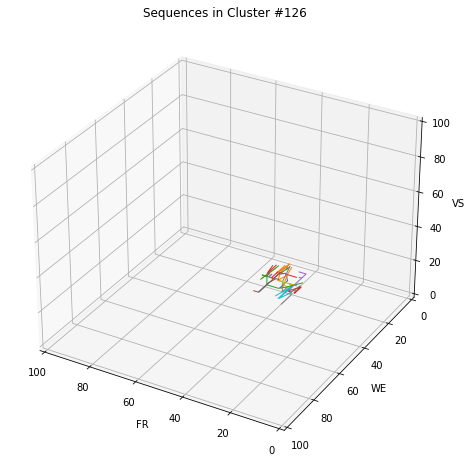

In [91]:
%matplotlib inline

fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')

for clr, trc in enumerate(dataset[for_viewing]):
    ax.plot(trc[:,0], trc[:,1], trc[:,2], 
            # c='r', 
            alpha=1, linewidth=1)

ax.set_xlim3d([0, 100])
ax.set_ylim3d([0, 100])
ax.set_zlim3d([0, 100])
ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
ax.set_title('')
ax.view_init(30, 105)

ax.set_title(f"Sequences in Cluster #{for_viewing}")
ax.view_init(azim=120, elev=30)
plt.show()

In [92]:
# Create HMM matrices for two models
# 0:FR, 1:WE, 2:VS
# hidden_param: to be predicted
# observable_param: input

# HMM model 1
hidden_param = 0
observable_param = 1
hmm1 = util.hmm_modelling(dataset, n_class, n_cluster, hidden_param, observable_param)

# HMM model 2
hidden_param = 0
observable_param = 2
hmm2 = util.hmm_modelling(dataset, n_class, n_cluster, hidden_param, observable_param)

In [93]:
%matplotlib ipympl

seqs_0, seqs_1, seqs_2 = [], [], []
for trace in dataset[for_viewing]:
    if trace[:,0].shape[0] < 2 or trace[:,1].shape[0] < 2:
        continue
    seq = list(zip(trace[:-1,0], trace[1:,0]))
    seqs_0.extend(seq)
    seq = list(zip(trace[:-1,1], trace[1:,1]))
    seqs_1.extend(seq)
    seq = list(zip(trace[:-1,2], trace[1:,2]))
    seqs_2.extend(seq)
# print(len(seqs_0))

fig, axs = plt.subplots(1, 5, figsize=(18, 4), gridspec_kw={'width_ratios': [5, 1, 1, 5, 5]}, num=f"The Making of HMM for Cluster #{for_viewing}")
fig.tight_layout()
axs[0].axis(False)
axs[0].set_title('Sequences in Score Space')
axs[1].set_xticks([0, 1])
axs[1].set_xticklabels(['A', 'B'])
# axs[1].set_ylim([0, n_class])
axs[2].axes.get_xaxis().set_visible(False)
axs[2].axes.get_yaxis().set_visible(False)
# axs[2].set_ylim([0, n_class])
axs[3].set_title('Transition')
axs[3].set_xlabel('FR-B')
axs[3].set_ylabel('FR-A')
axs[3].axes.get_xaxis().set_ticks([i for i in range(0, n_class, 5)])
axs[3].axes.get_yaxis().set_ticks([i for i in range(0, n_class, 5)])
axs[4].set_title('Emission')
axs[4].set_xlabel('FR')
axs[4].set_ylabel('VS')
axs[4].axes.get_xaxis().set_ticks([i for i in range(0, n_class, 5)])
axs[4].axes.get_yaxis().set_ticks([i for i in range(0, n_class, 5)])

ax = fig.add_subplot(1, 4, 1, projection='3d')
# ax.set_xlim3d([0, n_class])
# ax.set_ylim3d([0, n_class])
# ax.set_zlim3d([0, n_class])
ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
ax.set_title('')
# ax.view_init(15, 105)

grid_tr = np.zeros((n_class, n_class))
grid_em = np.zeros((n_class, n_class))

camera = Camera(fig)
ss = []
for seq_0, seq_1, seq_2 in tqdm(zip(seqs_0, seqs_1, seqs_2), total=len(seqs_0)):
    axs[1].plot(seq_0, c='k', alpha=0.25, linewidth=1)
    ss.append(seq_0)
    grid_tr[seq_0[1], seq_0[0]] = grid_tr[seq_0[1], seq_0[0]]  + 1
    grid_em[seq_2[0], seq_0[0]] = grid_em[seq_2[0], seq_0[0]]  + 1
    grid_em[seq_2[1], seq_0[1]] = grid_em[seq_2[1], seq_0[1]]  + 1
    for s in ss:
        axs[2].plot(s, c='k', alpha=0.25, linewidth=1)
    ax.plot(seq_0, seq_1, seq_2, c='r', linewidth=3)
    ax.scatter(seq_0, seq_1, seq_2, c='r', s=25)
    ax.text(seq_0[0], seq_1[0], seq_2[0], 'A', ha='right', va='top')
    ax.text(seq_0[1], seq_1[1], seq_2[1], 'B', ha='left', va='bottom')
    axs[3].imshow(grid_tr, cmap='gray')
    axs[4].imshow(grid_em, cmap='gray')
    camera.snap()

animation = camera.animate()

for trace in dataset[for_viewing]:
    ax.plot(trace[:,0], trace[:,1], trace[:,2], c='k', alpha=0.25, linewidth=1)

# Below is the illustration the creation of KB, the state (score) transition and emission matrices
# The actual KB is in matrix form
# The matrices converted to grayscale images to make visualization easy
# As the sequence transitions from one score state to another, the transition and emission matrices are updated
# Bright spots are the location where the probability is high

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

100%|██████████| 157/157 [00:09<00:00, 17.12it/s]


In [94]:
# animation.save('hmm_creation.gif', fps=5)
animation.event_source.stop()

In [95]:
# Smoothening Filter
# `sigma` indicates the how much of the smoothening is applied
sigma = 1

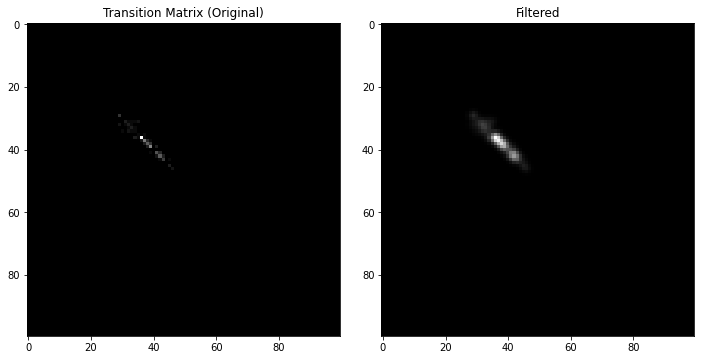

In [96]:
%matplotlib inline

from scipy.ndimage import gaussian_filter

fig, axs = plt.subplots(1, 2, figsize=(10,5), gridspec_kw={'width_ratios': [1, 1]})
fig.tight_layout()

axs[0].set_title('Transition Matrix (Original)')
axs[0].imshow(grid_tr, cmap='gray')
axs[1].set_title('Filtered')
axs[1].imshow(gaussian_filter(grid_tr, sigma=1), cmap='gray')

plt.show()

# Before and after comparison for Transition Matrix
# Relationship between HP previous and next HP states

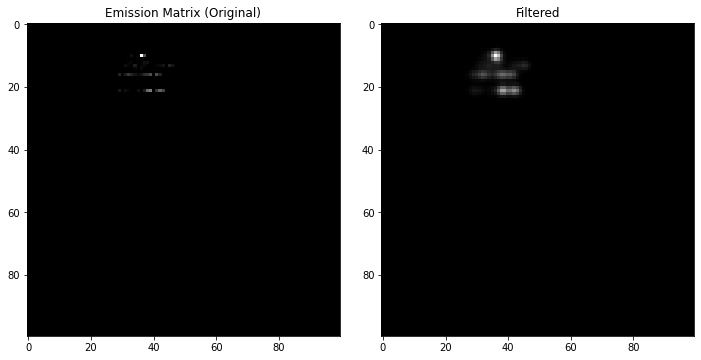

In [97]:
%matplotlib inline

from scipy.ndimage import gaussian_filter

fig, axs = plt.subplots(1, 2, figsize=(10,5), gridspec_kw={'width_ratios': [1, 1]})
fig.tight_layout()

axs[0].set_title('Emission Matrix (Original)')
axs[0].imshow(grid_em, cmap='gray')
axs[1].set_title('Filtered')
axs[1].imshow(gaussian_filter(grid_em, sigma=1), cmap='gray')

plt.show()

# Before and after comparison for Emission Matrix
# Relationship between OP and HP

In [98]:
# This concludes KB creation

## 4. Prediction

The prediction uses Viterbi Algorithm.  
The prediction uses OP as input to create HP path output.  

Metrics are delta AUC (area under curve) and MSE (mean squared error).  
Delta AUC is the difference of prediction from ground truth in term of percentage (smaller better).  
MSE is the average of squared difference of prediction from ground truth (smaller better).  

In [99]:
cluster_member_1, path1 = util.predict(scores, test_segment, est, hmm1, sigma)
cluster_member_2, path2 = util.predict(scores, test_segment, est, hmm2, sigma)

score = np.array([scores[i][test_segment] for i in range(3)])


AUC (area under curve) difference from ground truth : -85.8 %
MSE (mean squared error) from ground truth          : 5268


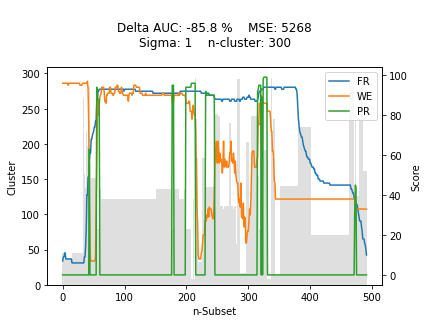

In [100]:
hidden_param = 0
observable_param = 1

plt.xlabel('n-Subset')
if True:
    plt.ylabel('Cluster')
    # plt.plot(cluster_member, color='k', linewidth=0.5)
    plt.bar(range(len(cluster_member_1)), cluster_member_1, width=1, facecolor='grey', alpha=0.25)
    plt.twinx()
    plt.ylabel('Score')
plt.plot(score[hidden_param], label='FR');
plt.plot(score[observable_param], label='WE');
plt.plot(path1, label='PR');
plt.legend(loc='best');

auc_truth = auc(range(len(score[hidden_param])), score[hidden_param])
auc_pred = auc(range(len(path1)), path1)
auc_diff = (auc_pred - auc_truth) / auc_truth

title_1 = '\nAUC (area under curve) difference from ground truth : {:.1f} %'.format(100 * auc_diff)
title_2 = f"MSE (mean squared error) from ground truth          : {round(mean_squared_error(score[hidden_param], path1))}"
print(title_1)
print(title_2)

plt.title('\nDelta AUC: {:.1f} %'.format(100 * auc_diff) + 
          '    ' + 
          'MSE: {}'.format(round(mean_squared_error(score[hidden_param], path1))) + 
          '\n' +
          f'Sigma: {sigma}' +
          '    '  +
          f'n-cluster: {n_cluster}' +
          '\n')

plt.show();

# The prediction from HMM model that uses WE as OP


AUC (area under curve) difference from ground truth : -0.2 %
MSE (mean squared error) from ground truth          : 23


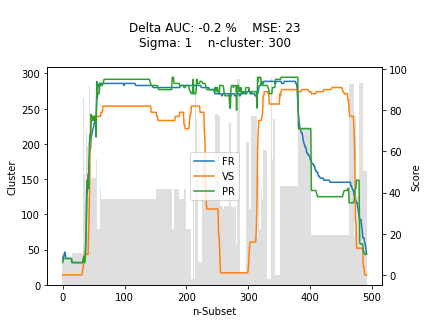

In [101]:
hidden_param = 0
observable_param = 2

plt.xlabel('n-Subset')
if True:
    plt.ylabel('Cluster')
    # plt.plot(cluster_member, color='k', linewidth=0.5)
    plt.bar(range(len(cluster_member_2)), cluster_member_2, width=1, facecolor='grey', alpha=0.25)
    plt.twinx()
    plt.ylabel('Score')
plt.plot(score[hidden_param], label='FR');
plt.plot(score[observable_param], label='VS');
plt.plot(path2, label='PR');
plt.legend(loc='best');

auc_truth = auc(range(len(score[hidden_param])), score[hidden_param])
auc_pred = auc(range(len(path2)), path2)
auc_diff = (auc_pred - auc_truth) / auc_truth

title_1 = '\nAUC (area under curve) difference from ground truth : {:.1f} %'.format(100 * auc_diff)
title_2 = f"MSE (mean squared error) from ground truth          : {round(mean_squared_error(score[hidden_param], path2))}"
print(title_1)
print(title_2)

plt.title('\nDelta AUC: {:.1f} %'.format(100 * auc_diff) + 
          '    ' + 
          'MSE: {}'.format(round(mean_squared_error(score[hidden_param], path2))) + 
          '\n' +
          f'Sigma: {sigma}' +
          '    '  +
          f'n-cluster: {n_cluster}' +
          '\n')

plt.show();

# The prediction from HMM model that uses VS as OP

## 5. Optional: Error Analysis

Given an error threshold, any cluster associated to an error exceeding the threshold in the `test_segment` can be identified.  
Therefore, it is possible to analyze the cluster shape and size.  

In [102]:
error_thresh = 10

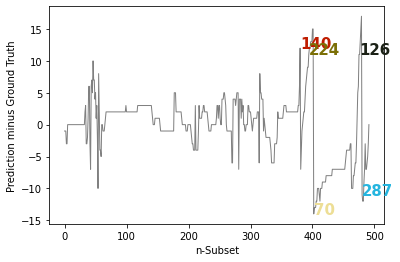

In [103]:
diff = path2 - score[hidden_param]
outside_thresh = np.unique(cluster_member_2[np.abs(diff) > error_thresh])
outside_location = [round(np.where((cluster_member_2 == ot) & (np.abs(diff) > error_thresh))[0].min()) for ot in outside_thresh]
for cn, loc in zip(outside_thresh, outside_location):
    np.random.seed(seed=cn)
    plt.annotate(cn, xy=(loc,diff[loc]), xytext =(loc,diff[loc]), fontsize=15, weight='bold', c=np.random.uniform(size=3))
np.random.seed(seed=None)
plt.plot(diff, c='gray', linewidth=1)
plt.xlabel('n-Subset')
plt.ylabel('Prediction minus Ground Truth')
plt.title('')
plt.show()

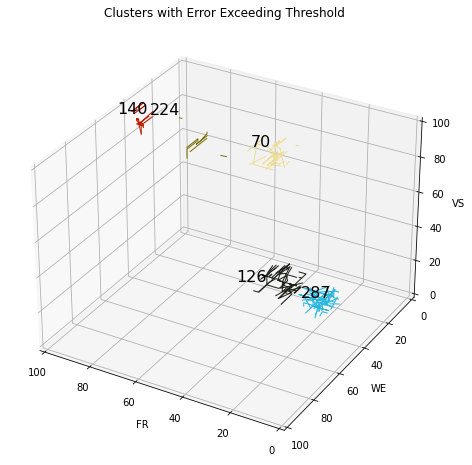

In [104]:
%matplotlib inline

fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')

for ot in outside_thresh:
    np.random.seed(seed=ot)
    clr = np.random.uniform(size=3)
    for trc in dataset[ot]:
        ax.plot(trc[:,0], trc[:,1], trc[:,2], c=clr, alpha=1, linewidth=1)
    ax.text(trc[:,0].mean(), trc[:,1].mean(), trc[:,2].mean(), ot, c='k', ha='right', va='bottom', fontsize=16)
np.random.seed(seed=None)

ax.set_xlim3d([0, 100])
ax.set_ylim3d([0, 100])
ax.set_zlim3d([0, 100])
ax.set_xlabel('FR')
ax.set_ylabel('WE')
ax.set_zlabel('VS')
ax.set_title('')
ax.view_init(30, 105)

ax.set_title(f"Clusters with Error Exceeding Threshold")
ax.view_init(azim=120, elev=30)

plt.show()

## 6. Optional: Revert Score back to Original Unit Dimension

It is possible to convert score back to original unit dimension, as each score is the average time-series cluster center.  

In [105]:
ts_est, hash_fr = estimators[0]
ts_centers = ts_est.cluster_centers_
dehash = {v: ts_centers[k].mean() for k, v in hash_fr.items()}

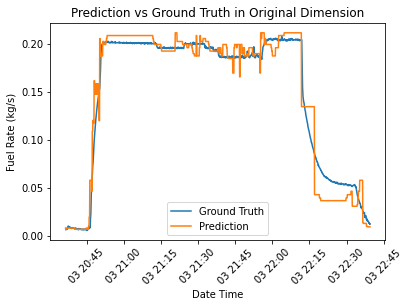

In [106]:
prediction = [dehash[p] for p in path2]
prediction = [prediction for _ in range((time_constant-stride)//stride)]
prediction = np.array(prediction).T.flatten()
index = segments[test_segment].index[:np.min([segments[test_segment].index.shape[0], prediction.shape[0]])]

plt.title('')
plt.plot(index, segments[test_segment].sum(axis=1).to_numpy()[:index.shape[0]], label='Ground Truth')
plt.plot(index, prediction[:index.shape[0]], label='Prediction')
plt.xticks(rotation=45)
plt.xlabel('Date Time')
plt.ylabel('Fuel Rate (kg/s)')
plt.legend(loc='best')
plt.title('Prediction vs Ground Truth in Original Dimension')
plt.show()